In [1]:
import ruptures as rpt
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import pybedtools
import time

In [2]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-

#Scrip to remove artifacts.
import pandas as pd
import numpy as np
import pybedtools
import matplotlib.pyplot as plt

#Creates a bed file from an array
def create_bed_from_array(array):

    data_array = []
    if len(array) % 2 != 0:
        array=array[:-1] #Remove last value
    for i in range(0, len(array), 2):
        data_array.append(["PA_chr01", array[i],array[i+1]])
    np_array = np.array(data_array)
    dataframe = pd.DataFrame(np_array)
    return pybedtools.BedTool.from_dataframe(dataframe)

#Removes exact matches from an array
def remove_artifacts_exact(reference, individual):
    ref_set = set(ref)
    deletions = [x for x in ind1 if x not in ref_set]
    return deletions

#Removes matches in a window, w=1000 is the extension of the window.
def remove_artifacts_window(ref_bed, ind_bed):
    ind5_bkps_bed = pybedtools.BedTool(ind_bed)
    ref_bkps_bed = pybedtools.BedTool(ref_bed)
    return ind5_bkps_bed.window(ref_bkps_bed, w=10, v=True)

def bed_to_array(bed):
    # df=pd.read_csv('removed_artifacts_pred.bed',header=None, sep='\t')
    # col_one_arr = df[1].to_numpy()
    # col_two_arr = df[2].to_numpy()
    # start_stop=np.array([0,size])
    # arr = np.concatenate((col_one_arr, col_two_arr))
    # arr = np.concatenate((arr, start_stop))

    # arr=np.sort(arr)

    return pybedtools.BedTool.to_dataframe(bed).loc[:, ["start", "end"]].to_numpy().flatten()

#Filter and remove artifacts
def pred_breakpoints_remove_artifacts(ref_arr, pred_arr, coverage_array, thr):
        filter_arr=filter_coverage(pred_arr, thr, coverage_array) #Filter some threshold
        pred_filtred_bed=create_bed_from_array(filter_arr) #create bed file
        ref_bed=create_bed_from_array(ref_arr)
        rem_pred_filter=remove_artifacts_window(ref_bed,pred_filtred_bed)
        return pred_filtred_bed #rem_pred_filter #
    
def pred_breakpoints(pred_arr, coverage_array, thr):
        filter_arr=filter_coverage(pred_arr, thr, coverage_array) #Filter some threshold
        pred_filtred_bed=create_bed_from_array(filter_arr) #create bed file
        #ref_bed=create_bed_from_array(ref_arr)
        #rem_pred_filter=remove_artifacts_window(ref_bed,pred_filtred_bed)
        return pred_filtred_bed #rem_pred_filter #

def filter_coverage(pred_array, threshold, coverage_array):
    avg_cov_arr=[]
    pred_filterd=[]
    for i in range(len(pred_array)-1):
        start=pred_array[i]
        stop=pred_array[i+1]

        temp=coverage_array[start: stop]

        avg_coverage=sum(temp)/len(temp)
        if avg_coverage<threshold:
            pred_filterd.extend([start, stop])

        avg_cov_arr.append(avg_coverage)
    return pred_filterd


In [3]:
def extract_data(path, row): 
    data=pd.read_csv(path, header=None, sep='\t')
    #Extract the individual sample
    individual=np.array(data[row])

    #Extract the reference
    reference=np.array(data[2])
    return individual, reference 

In [4]:
def window(individual, reference, pen_ind, pen_ref, width, min_size): 

    #Define the model and algoritm
    model = "l2"  # "l1", "rbf", "linear", "normal", "ar"

    #Fit the data - uncommet this to try different models
    algo = rpt.Window(width=width, model=model, min_size=min_size).fit(individual)
    algo_ref = rpt.Window(width=width, model=model, min_size=min_size).fit(reference)

    #Predict the breakpoints for the individual and reference
    ind_bkps = algo.predict(pen=pen_ind) 
    ref_bkps = algo_ref.predict(pen=pen_ref)
    return ind_bkps, ref_bkps

In [5]:
def bottomUp(individual, reference, pen_ind, pen_ref, min_size): 

    #Define the model and algoritm
    model = "l2"  # "l1", "rbf", "linear", "normal", "ar"

    #Fit the data - uncommet this to try different models
    algo = rpt.BottomUp(model=model, min_size=min_size).fit(individual)
    algo_ref = rpt.BottomUp(model=model, min_size=min_size).fit(reference)

    #Predict the breakpoints for the individual and reference
    ind_bkps = algo.predict(pen=pen_ind)
    ref_bkps = algo_ref.predict(pen=pen_ref)
    return ind_bkps, ref_bkps

In [6]:
# Show the data
def display_data(individual, ind_bkps, reference, ref_bkps):
    rpt.display(individual, ind_bkps, figsize=(100, 6))
    plt.title('Before filtering and artifacts removal')
    plt.show()

    #Show the reference 
    rpt.display(reference, ref_bkps, figsize=(100, 6))
    plt.title('Reference')
    plt.show()

In [7]:
def display_filtered_old(ref_bkps , ind_bkps, individual, threshold): 
    rem_pred_filter=pred_breakpoints(ref_bkps , ind_bkps, individual, threshold)
    rem_pred_filter_arr=bed_to_array(rem_pred_filter)
   # true_bkps_arr=bed_to_array(true_bkps_bed)
    rpt.display(individual, rem_pred_filter_arr, figsize=(100, 6))
    plt.title('After filtering')
    plt.show()
    return rem_pred_filter

In [8]:
def display_filtered(ind_bkps, individual, threshold): 
    rem_pred_filter=pred_breakpoints(ind_bkps, individual, threshold)
    rem_pred_filter_arr=bed_to_array(rem_pred_filter)
   # true_bkps_arr=bed_to_array(true_bkps_bed)
    rpt.display(individual, rem_pred_filter_arr, figsize=(100, 6))
    plt.title('After filtering')
    plt.show()
    return rem_pred_filter

In [9]:
#Extract data
individual, reference=extract_data('1mil', 5)
individual_2mil, reference_2mil=extract_data('2mil', 5)

EmptyDataError: No columns to parse from file

13.518129110336304


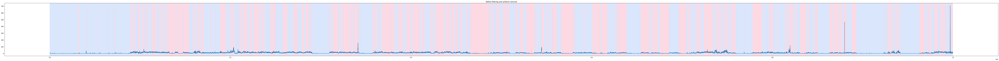

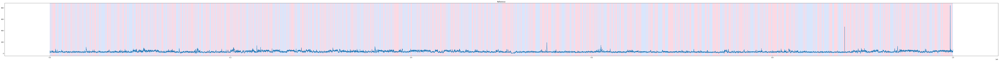

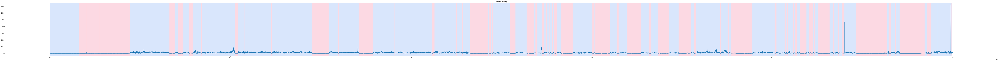

In [16]:
#Calculate break points 12.5x BottomUp
t0 = time.time()
ind_bkps, ref_bkps=bottomUp(individual, reference, 10**4, 10**4, 100)
t1 = time.time()
r=t1-t0
print(r)
#Display and filter 

display_data(individual, ind_bkps, reference, ref_bkps)
rem_pred_filter=display_filtered(ref_bkps , ind_bkps, individual, 6)


In [ ]:
a[a > 10] = 0

In [27]:
individual[individual > 30 ] = 30
reference[reference > 30 ] = 30

13.777655124664307


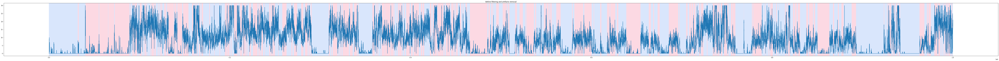

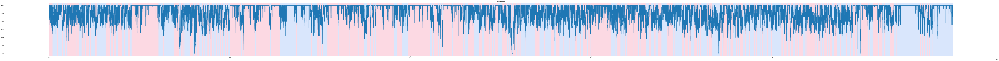

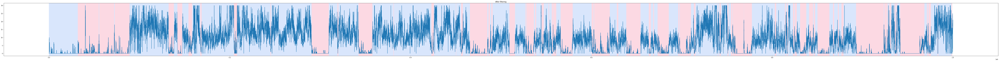

In [28]:
#Calculate break points 12.5x BottomUp
t0 = time.time()
ind_bkps, ref_bkps=bottomUp(individual, reference, 10**4, 10**4, 100)
t1 = time.time()
r=t1-t0
print(r)
#Display and filter 

display_data(individual, ind_bkps, reference, ref_bkps)
rem_pred_filter=display_filtered(ref_bkps , ind_bkps, individual, 6)


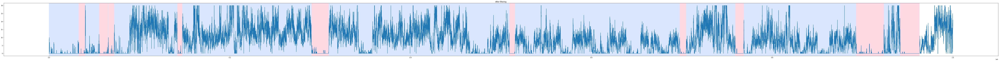

In [30]:
rem_pred_filter=display_filtered(ref_bkps , ind_bkps, individual, 0.5)


In [31]:
#Extract data
individual, reference=extract_data('1mil', 6)

In [32]:
individual[individual > 30 ] = 30
reference[reference > 30 ] = 30

13.70105791091919


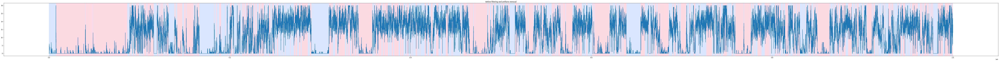

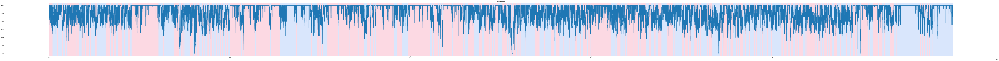

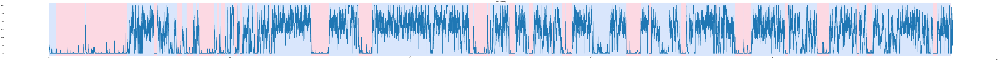

In [33]:
#Calculate break points 12.5x BottomUp
t0 = time.time()
ind_bkps, ref_bkps=bottomUp(individual, reference, 10**4, 10**4, 100)
t1 = time.time()
r=t1-t0
print(r)
#Display and filter 

display_data(individual, ind_bkps, reference, ref_bkps)
rem_pred_filter=display_filtered(ref_bkps , ind_bkps, individual, 1)


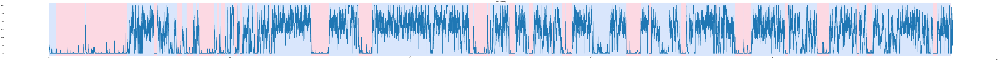

In [37]:
rem_pred_filter=display_filtered(ref_bkps , ind_bkps, individual, 1)


13.780598163604736


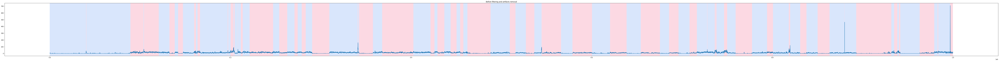

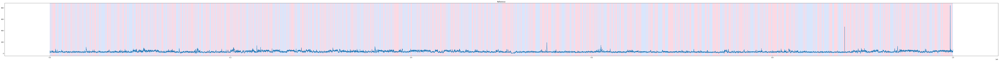

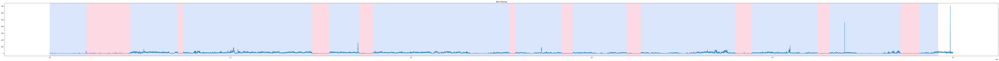

In [40]:
#Calculate break points BottomUp
t0 = time.time()
ind_bkps, ref_bkps=bottomUp(individual, reference, 10**5, 10**4, 100)
t1 = time.time()
r=t1-t0
print(r)
#Display and filter 

display_data(individual, ind_bkps, reference, ref_bkps)
rem_pred_filter=display_filtered(ref_bkps , ind_bkps, individual, 1)

In [41]:
individual[individual > 30 ] = 30
reference[reference > 30 ] = 30

13.765289068222046


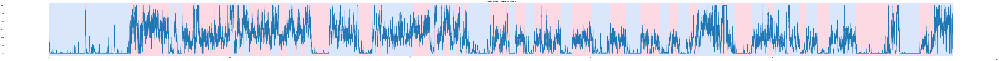

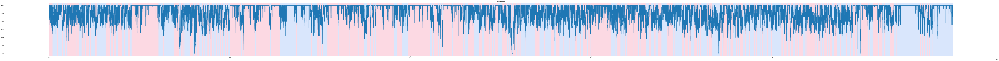

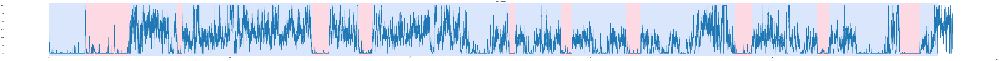

In [42]:
#Calculate break points BottomUp
t0 = time.time()
ind_bkps, ref_bkps=bottomUp(individual, reference, 10**5, 10**4, 100)
t1 = time.time()
r=t1-t0
print(r)
#Display and filter 

display_data(individual, ind_bkps, reference, ref_bkps)
rem_pred_filter=display_filtered(ref_bkps , ind_bkps, individual, 1)

In [ ]:
display_data(individual_2mil, ind_bkps, reference_2mil, ref_bkps)


46.2825129032135


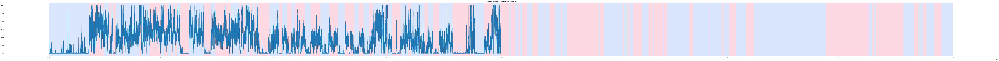

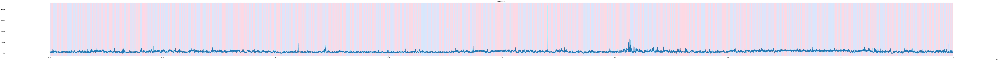

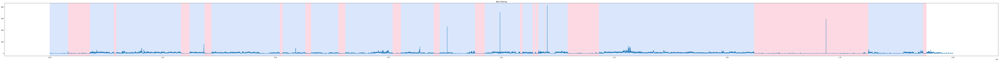

In [44]:
#Calculate break points BottomUp
t0 = time.time()
ind_bkps, ref_bkps=bottomUp(individual_2mil, reference_2mil, 10**5, 10**4, 100)
t1 = time.time()
r=t1-t0
print(r)
#Display and filter 

display_data(individual_2mil, ind_bkps, reference_2mil, ref_bkps)
rem_pred_filter=display_filtered(ref_bkps , ind_bkps, individual_2mil, 1)

In [45]:
individual_2mil[individual_2mil > 30 ] = 30
reference_2mil[reference_2mil > 30 ] = 30

46.896475076675415


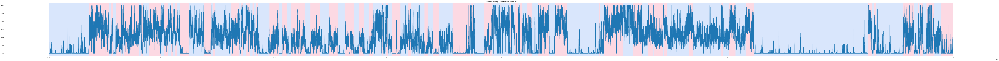

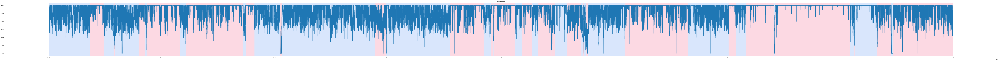

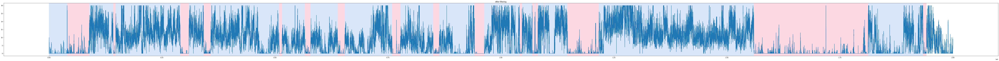

In [47]:
#Calculate break points BottomUp
t0 = time.time()
ind_bkps, ref_bkps=bottomUp(individual_2mil, reference_2mil, 10**5, 10**5, 100)
t1 = time.time()
r=t1-t0
print(r)
#Display and filter 

display_data(individual_2mil, ind_bkps, reference_2mil, ref_bkps)
rem_pred_filter=display_filtered(ref_bkps , ind_bkps, individual_2mil, 1)

In [59]:
import gzip


while 

line_counter = 0
f = open("test"+str(line_counter), "w")



start = 0
stop = 2000000
with gzip.open("PA_chr01.depth.gz") as file:
    for line in file:
        line = line.decode()
        line_counter += 1
        if line_counter >= start and line_counter < stop:
            f.write(line)
        elif line_counter >= stop:
            break

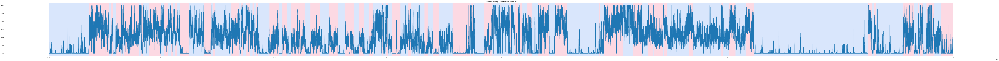

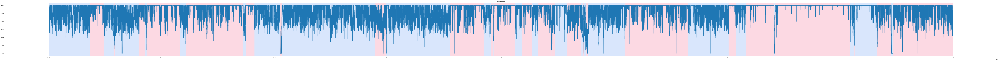

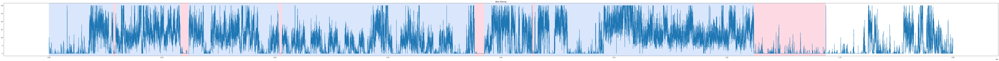

In [60]:
display_data(individual_2mil, ind_bkps, reference_2mil, ref_bkps)
rem_pred_filter=display_filtered(ref_bkps , ind_bkps, individual_2mil, 0.5)

In [83]:
def extract_all_col(path): 
    col=3
    data=pd.read_csv(path, header=None, sep='\t')
    
    #Define the model and algoritm
    model = "l2"  # "l1", "rbf", "linear", "normal", "ar"
    min_size=100
    pen_ref=10**5
    pen_ind=10**5
    #Extract the reference
    reference=np.array(data[2])
    reference[reference > 30 ] = 30
    t0 = time.time()
    algo_ref = rpt.BottomUp(model=model, min_size=min_size).fit(reference)
    ref_bkps = algo_ref.predict(pen=pen_ref)
    t1 = time.time()
    print("Reference: ")
    print(t1-t0)
    
    #Show the reference 
    rpt.display(reference, ref_bkps, figsize=(100, 6))
    plt.title('Reference')
    plt.show()
    
    #Extract the individual sample
    while col < len(data.columns):
        individual=np.array(data[col])
        individual[individual > 30 ] = 30
         #Fit the data - uncommet this to try different models
        t0 = time.time()
        algo = rpt.BottomUp(model=model, min_size=min_size).fit(individual)
   
        #Predict the breakpoints for the individual and reference
        ind_bkps = algo.predict(pen=pen_ind)
        t1 = time.time()
        print("Sample:" + str(col))
        print(t1-t0)
        display_filtered(ind_bkps, individual, 1)
        
        col=col+1


Reference: 
23.381010055541992


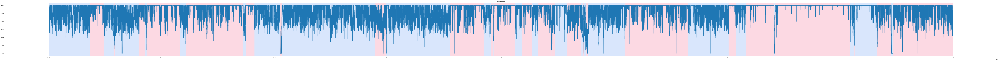

Sample:3
23.48442006111145


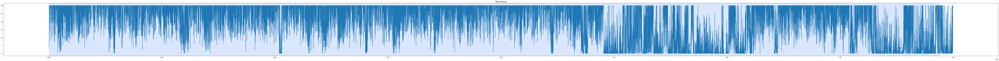

Sample:4
23.232970237731934


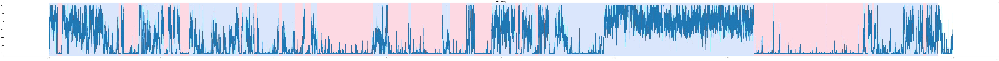

Sample:5
23.46542716026306


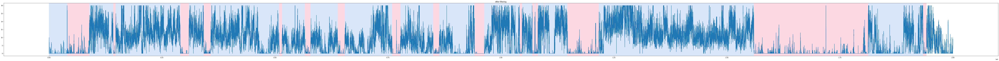

Sample:6
23.38775396347046


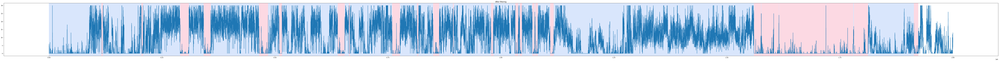

Sample:7
23.419251918792725


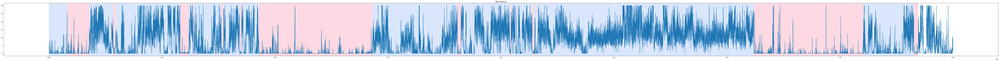

Sample:8
23.439085960388184


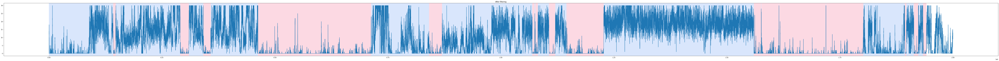

Sample:9
23.669875860214233


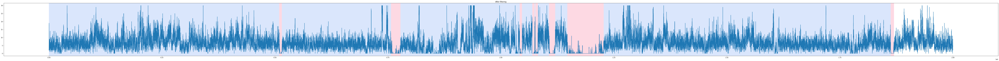

Sample:10
23.58358883857727


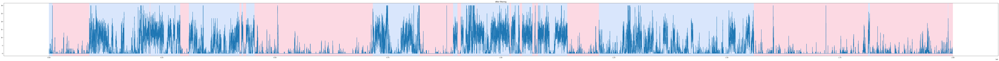

Sample:11
23.618353128433228


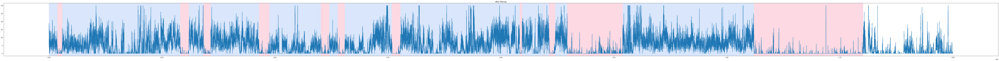

Sample:12
23.675012826919556


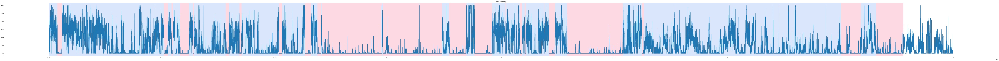

Sample:13
23.549965858459473


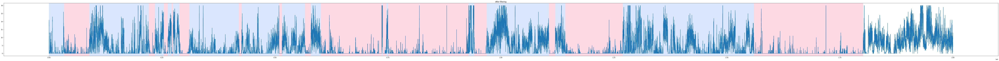

Sample:14
23.58352828025818


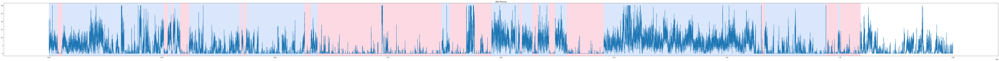

Sample:15
23.659100770950317


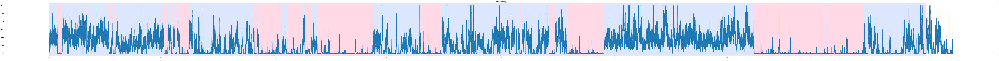

Sample:16
23.662301063537598


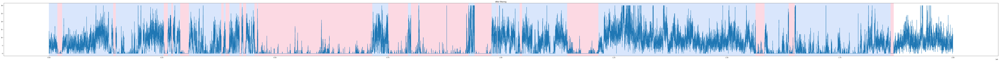

Sample:17
23.60315489768982


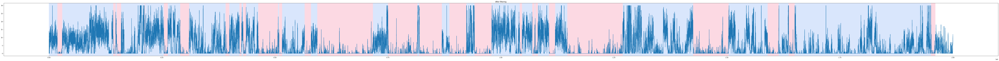

Sample:18
23.614810705184937


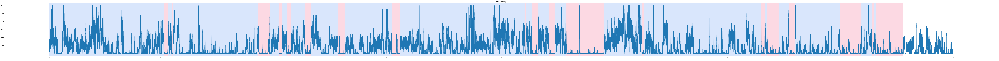

Sample:19
23.744508028030396


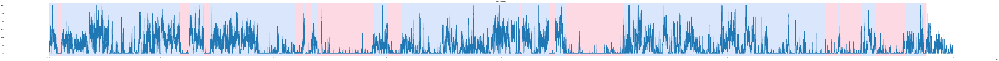

Sample:20
23.712698698043823


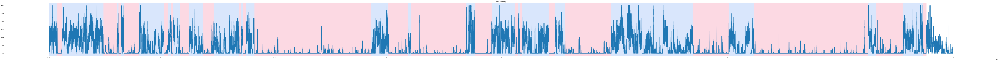

Sample:21
23.663076877593994


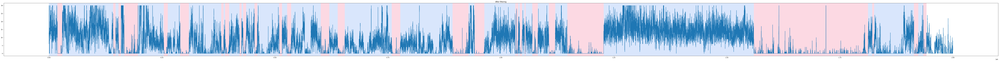

In [84]:
extract_all_col('2mil')

In [13]:
def calc_all_col(path, pen_ref, pen_ind, threshold): 
    col=3
    data=pd.read_csv(path, header=None, sep='\t')
    
    #Define the model and algoritm
    model = "l2"  # "l1", "rbf", "linear", "normal", "ar"
    min_size=100
    #pen_ref=10**5
    #pen_ind=10**5
    #Extract the reference
    reference=np.array(data[2])
    reference[reference > 30 ] = 30
    t0 = time.time()
    algo_ref = rpt.BottomUp(model=model, min_size=min_size).fit(reference)
    ref_bkps = algo_ref.predict(pen=pen_ref)
    t1 = time.time()
    print("Reference: ")
    print(t1-t0)
    
    #Show the reference 
    rpt.display(reference, ref_bkps, figsize=(100, 6))
    plt.title('Reference')
    plt.show()
    
    #Extract the individual sample
    while col < len(data.columns):
        individual=np.array(data[col])
        individual[individual > 30 ] = 30
         #Fit the data - uncommet this to try different models
        t0 = time.time()
        algo = rpt.BottomUp(model=model, min_size=min_size).fit(individual)
   
        #Predict the breakpoints for the individual and reference
        ind_bkps = algo.predict(pen=pen_ind)
        t1 = time.time()
        print("Sample:" + str(col))
        print(t1-t0)
        display_filtered(ind_bkps, individual, threshold)
        
        col=col+1

Reference: 
23.060646772384644


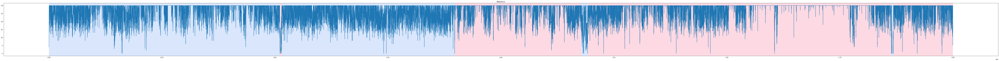

Sample:4
23.279204845428467


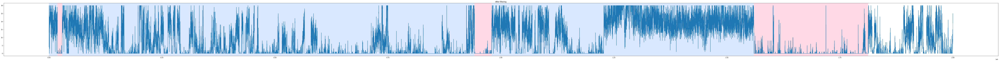

Sample:5
23.503567934036255


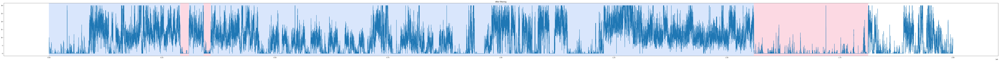

Sample:6
23.47022008895874


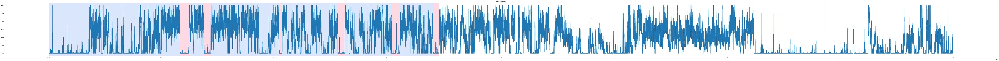

Sample:7
23.484772205352783


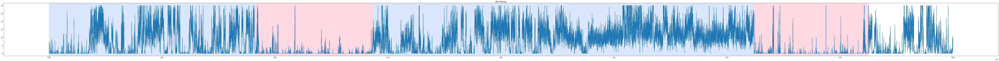

Sample:8
23.49644422531128


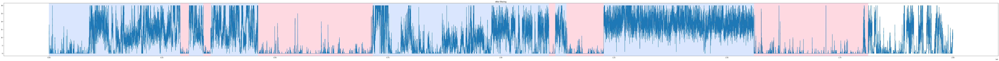

Sample:9
23.678861141204834


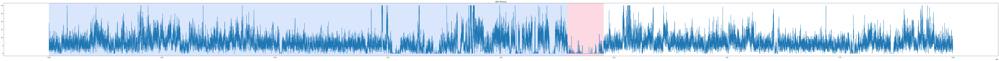

Sample:10
23.555724143981934


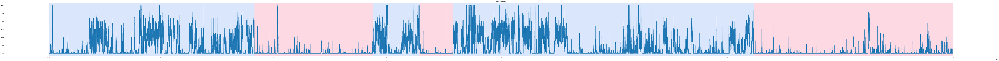

Sample:11
23.53179121017456


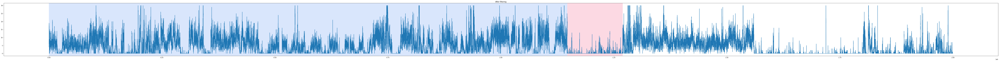

Sample:12
23.57200312614441


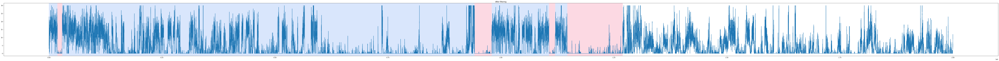

Sample:13
23.47233510017395


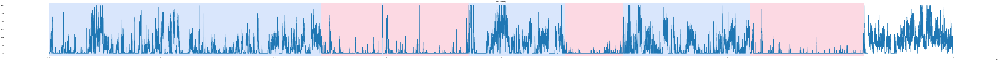

Sample:14
23.61251926422119


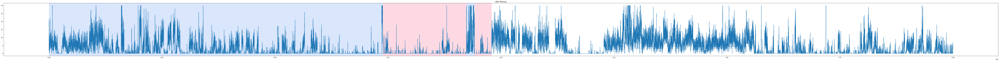

Sample:15
23.58321213722229


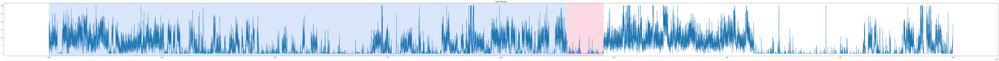

Sample:16
23.6024169921875


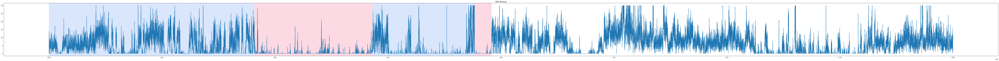

Sample:17
23.479418992996216


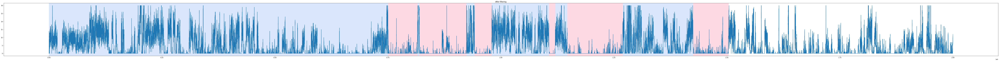

Sample:18
23.647460222244263


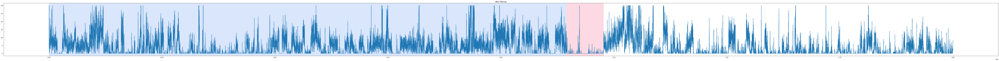

Sample:19
23.69417095184326


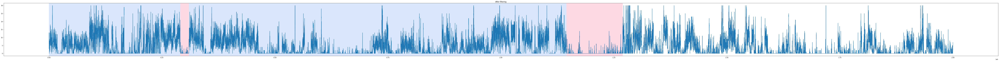

Sample:20
23.578166007995605


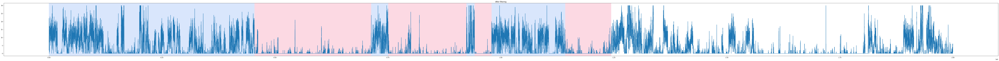

Sample:21
23.50925087928772


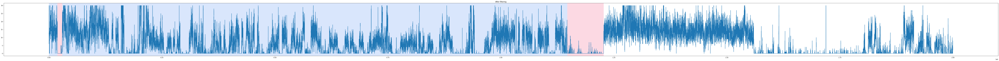

In [11]:
calc_all_col('2mil',10**6,10**6 , 1)

Reference: 
23.308186054229736


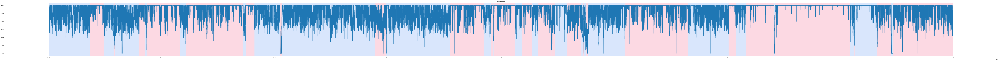

Sample:4
23.131408214569092


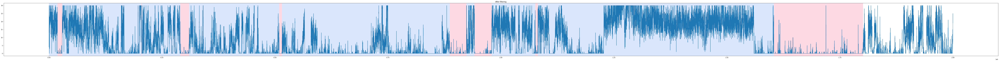

Sample:5
23.355034828186035


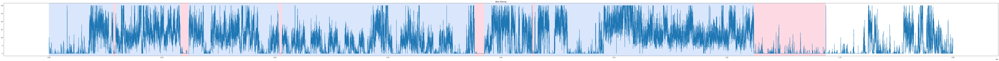

Sample:6
23.553637981414795


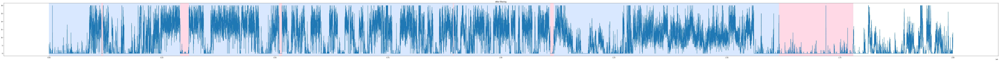

Sample:7
23.485899925231934


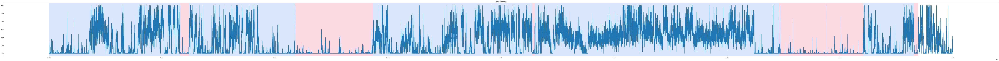

Sample:8
23.47393798828125


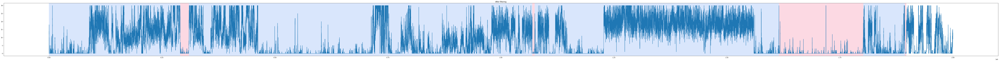

Sample:9
23.760315895080566


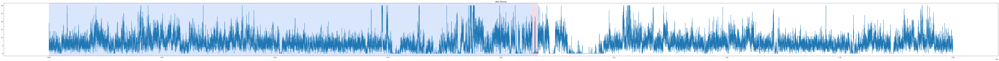

Sample:10
23.492806911468506


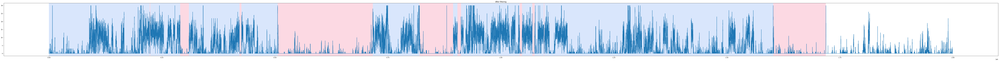

Sample:11
23.700846195220947


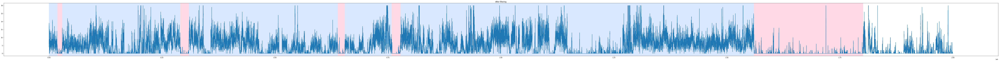

Sample:12
23.540460109710693


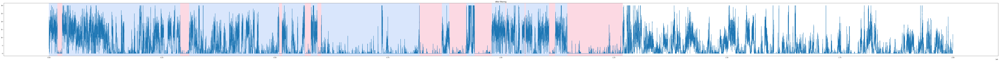

Sample:13
23.531641006469727


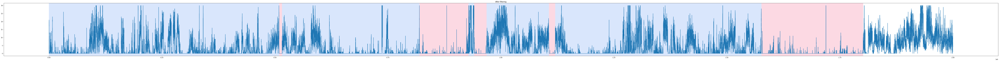

Sample:14
23.55890202522278


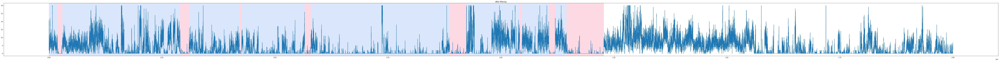

Sample:15
23.506996870040894


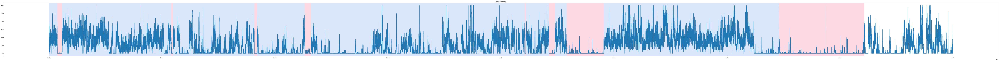

Sample:16
23.76920986175537


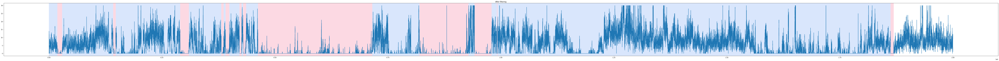

Sample:17
23.539432048797607


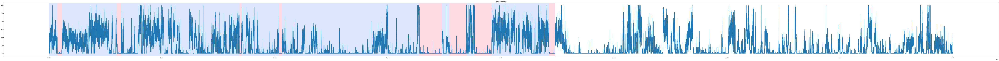

Sample:18
23.68483591079712


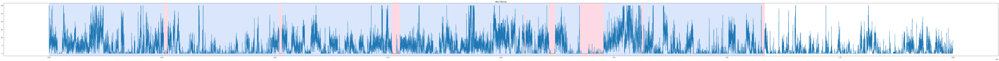

Sample:19
23.623369932174683


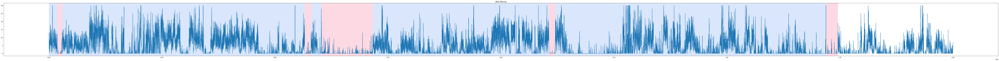

Sample:20
23.762727975845337


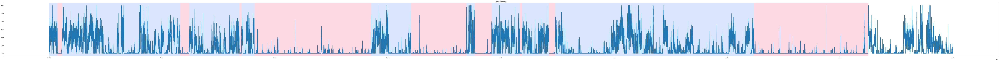

Sample:21
23.7726731300354


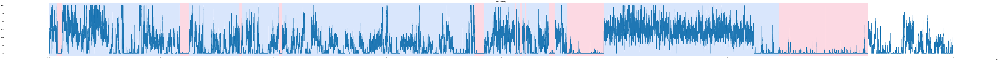

In [12]:
calc_all_col('2mil',10**5,10**5 , 0.5)

Reference: 
23.477160930633545


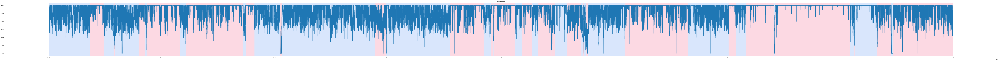

Sample:3
23.594291925430298


KeyError: "None of [Index(['start', 'end'], dtype='object')] are in the [columns]"

In [14]:
calc_all_col('2mil',10**5,10**5 , 0.5)